In [ ]:
import os
import sys
import matplotlib.pyplot as plt
clipstyler_dir = os.path.join("/content", "clipstyler")

!pip install ftfy regex tqdm
!pip install git+https://github.com/openai/CLIP.git
!git clone https://github.com/paper11667/CLIPstyler/ $clipstyler_dir
sys.path.append(clipstyler_dir)

from PIL import Image
import numpy as np
import sys
import torch
import torch.nn
import torch.optim as optim
from torchvision import transforms, models

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 1.5 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-89paatlu
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-89paatlu
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_

In [ ]:
# you will be prompted with a window asking to grant permissions
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
# fill in the path in your Google Drive in the string below. Note: do not escape slashes or spaces
import os
datadir = "/content/CS444_sp24_code"
if not os.path.exists(datadir):
  !ln -s "/content/drive/My Drive/CS444_sp24_code" $datadir # TODO: Fill your Assignment 4 path
os.chdir(datadir)
!pwd

/content/drive/.shortcut-targets-by-id/1O6lf72x2O4rcW43Bsb2H1u0NOxcNuEmT/CS444_sp24_code


In [ ]:

import StyleNet_new
import utils
import clip
import torch.nn.functional as F
from template import imagenet_templates

from PIL import Image
import PIL
from torchvision import utils as vutils
import argparse
from torchvision.transforms.functional import adjust_contrast

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
def img_denormalize(image):
    mean=torch.tensor([0.485, 0.456, 0.406]).to(device)
    std=torch.tensor([0.229, 0.224, 0.225]).to(device)
    mean = mean.view(1,-1,1,1)
    std = std.view(1,-1,1,1)

    image = image*std +mean
    return image

def img_normalize(image):
    mean=torch.tensor([0.485, 0.456, 0.406]).to(device)
    std=torch.tensor([0.229, 0.224, 0.225]).to(device)
    mean = mean.view(1,-1,1,1)
    std = std.view(1,-1,1,1)

    image = (image-mean)/std
    return image

def clip_normalize(image,device):
    image = F.interpolate(image,size=224,mode='bicubic')
    mean=torch.tensor([0.48145466, 0.4578275, 0.40821073]).to(device)
    std=torch.tensor([0.26862954, 0.26130258, 0.27577711]).to(device)
    mean = mean.view(1,-1,1,1)
    std = std.view(1,-1,1,1)

    image = (image-mean)/std
    return image


def get_image_prior_losses(inputs_jit):
    diff1 = inputs_jit[:, :, :, :-1] - inputs_jit[:, :, :, 1:]
    diff2 = inputs_jit[:, :, :-1, :] - inputs_jit[:, :, 1:, :]
    diff3 = inputs_jit[:, :, 1:, :-1] - inputs_jit[:, :, :-1, 1:]
    diff4 = inputs_jit[:, :, :-1, :-1] - inputs_jit[:, :, 1:, 1:]

    loss_var_l2 = torch.norm(diff1) + torch.norm(diff2) + torch.norm(diff3) + torch.norm(diff4)

    return loss_var_l2

In [ ]:
resnet152 = models.resnet152(pretrained=True)
modules=list(resnet152.children())[:-1]
resnet152=torch.nn.Sequential(*modules)
for p in resnet152.parameters():
    p.requires_grad = False

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:01<00:00, 124MB/s] 


In [ ]:
resnet152.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
import os

def list_jpg_files(directory):
    files = os.listdir(directory)
    jpg_files = [file for file in files if file.endswith('.png')]
    return jpg_files

directory_path = './train_data'
jpg_files = list_jpg_files(directory_path)
print(jpg_files)


['0017x4.png', '0004x4.png', '0029x4.png', '0019x4.png', '0030x4.png', '0009x4.png', '0012x4.png', '0010x4.png', '0018x4.png', '0006x4.png', '0025x4.png', '0023x4.png', '0027x4.png', '0031x4.png', '0014x4.png', '0011x4.png', '0007x4.png', '0028x4.png', '0015x4.png', '0026x4.png', '0016x4.png', '0001x4.png', '0002x4.png', '0022x4.png', '0005x4.png', '0003x4.png', '0024x4.png', '0021x4.png', '0020x4.png', '0013x4.png', '0008x4.png', '0067x4.png', '0099x4.png', '0065x4.png', '0125x4.png', '0041x4.png', '0051x4.png', '0056x4.png', '0042x4.png', '0074x4.png', '0064x4.png', '0077x4.png', '0095x4.png', '0038x4.png', '0083x4.png', '0036x4.png', '0035x4.png', '0058x4.png', '0068x4.png', '0039x4.png', '0061x4.png', '0047x4.png', '0123x4.png', '0092x4.png', '0043x4.png', '0120x4.png', '0119x4.png', '0079x4.png', '0040x4.png', '0045x4.png', '0087x4.png', '0066x4.png', '0076x4.png', '0096x4.png', '0088x4.png', '0052x4.png', '0062x4.png', '0109x4.png', '0091x4.png', '0122x4.png', '0111x4.png', '0034

In [ ]:
StyleNet_new

<module 'StyleNet_new' from '/content/drive/.shortcut-targets-by-id/1O6lf72x2O4rcW43Bsb2H1u0NOxcNuEmT/CS444_sp24_code/StyleNet_new.py'>

100%|███████████████████████████████████████| 338M/338M [00:05<00:00, 64.0MiB/s]
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:143: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


After 100 iters:
Total loss:  8084.36279296875
Content loss:  0.044881634414196014
patch loss:  0.8642578125
dir loss:  0.59228515625
TV loss:  1.3801332712173462
prompt : pencil Sketch


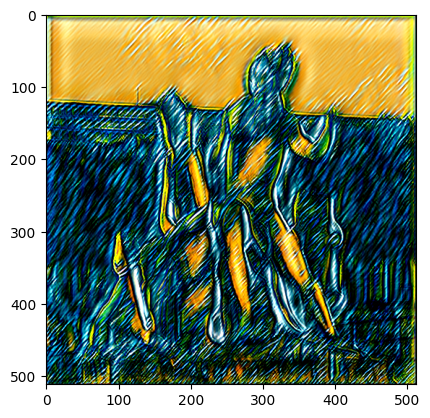

After 100 iters:
Total loss:  6923.80029296875
Content loss:  0.048200394958257675
patch loss:  0.73095703125
dir loss:  0.66796875
TV loss:  2.5702438354492188
prompt : fire


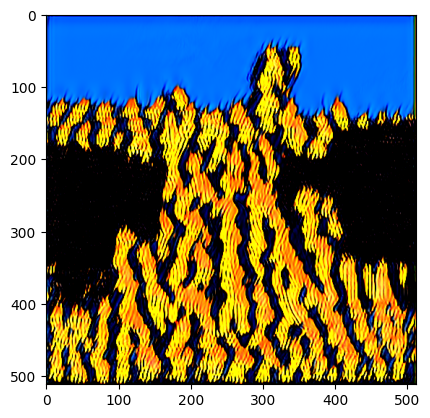

After 100 iters:
Total loss:  1704.922119140625
Content loss:  0.052730970084667206
patch loss:  0.1544189453125
dir loss:  0.61083984375
TV loss:  1.5124629735946655
prompt : neon light


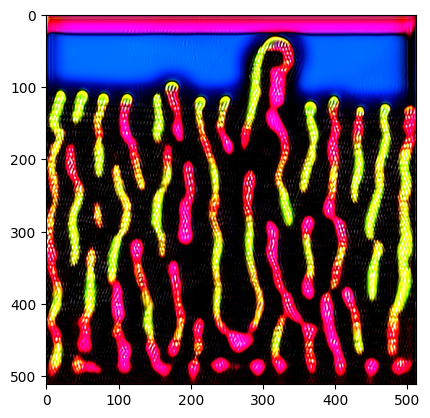

After 100 iters:
Total loss:  6502.45361328125
Content loss:  0.05357961356639862
patch loss:  0.685546875
dir loss:  0.65087890625
TV loss:  0.9163190722465515
prompt : pop themed nightlife


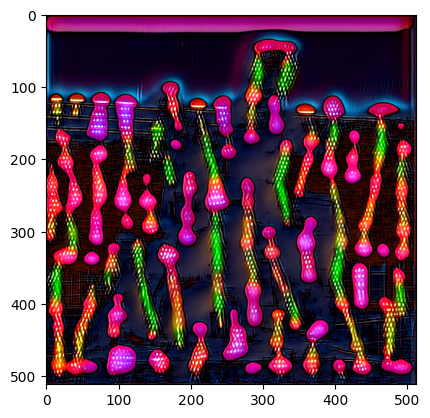

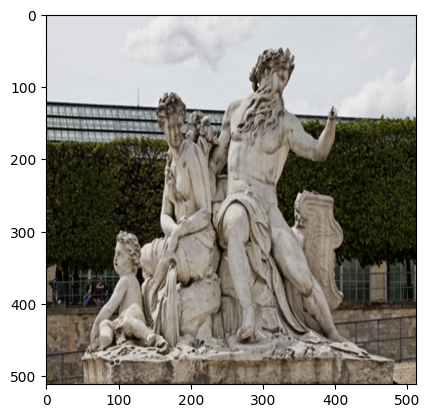

--------------------------

After 100 iters:
Total loss:  7923.806640625
Content loss:  0.04714784771203995
patch loss:  0.83544921875
dir loss:  0.7919921875
TV loss:  0.7344166040420532
prompt : pencil Sketch


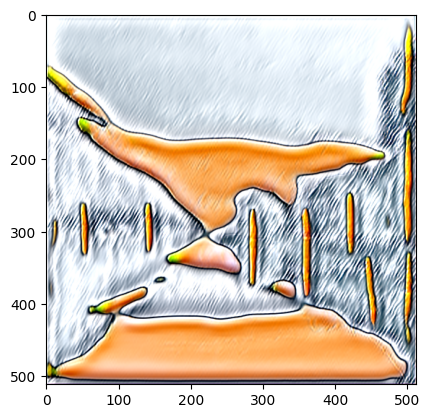

After 100 iters:
Total loss:  6795.90625
Content loss:  0.05072413757443428
patch loss:  0.71533203125
dir loss:  0.6982421875
TV loss:  3.29788875579834
prompt : fire


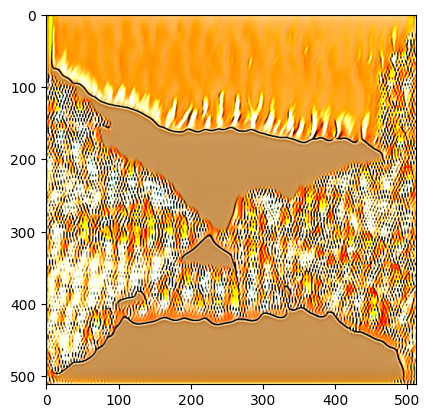

After 100 iters:
Total loss:  5258.71630859375
Content loss:  0.055695950984954834
patch loss:  0.5458984375
dir loss:  0.6728515625
TV loss:  1.8616868257522583
prompt : neon light


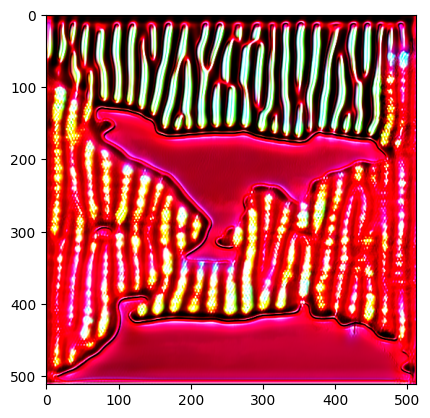

After 100 iters:
Total loss:  6832.45654296875
Content loss:  0.05453077331185341
patch loss:  0.7216796875
dir loss:  0.654296875
TV loss:  1.0266114473342896
prompt : pop themed nightlife


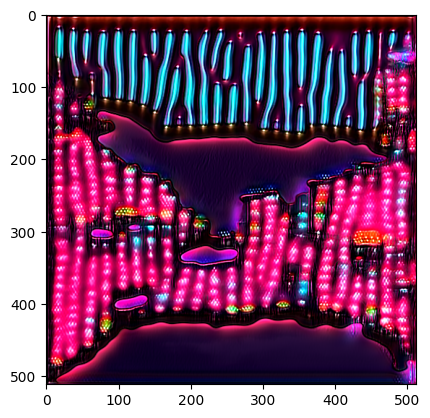

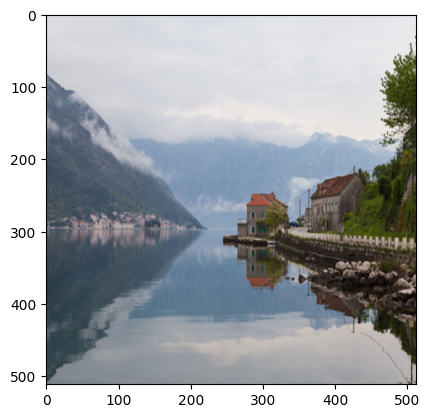

--------------------------

After 100 iters:
Total loss:  7294.599609375
Content loss:  0.05324549973011017
patch loss:  0.77392578125
dir loss:  0.6435546875
TV loss:  0.8627047538757324
prompt : pencil Sketch


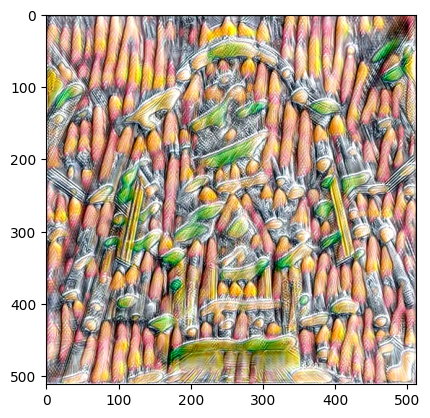

After 100 iters:
Total loss:  7126.63037109375
Content loss:  0.06168895214796066
patch loss:  0.75537109375
dir loss:  0.63134765625
TV loss:  1.626910924911499
prompt : fire


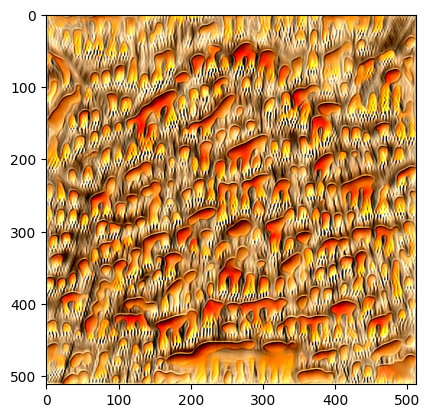

After 100 iters:
Total loss:  7032.03466796875
Content loss:  0.061967264860868454
patch loss:  0.74169921875
dir loss:  0.689453125
TV loss:  1.9896067380905151
prompt : neon light


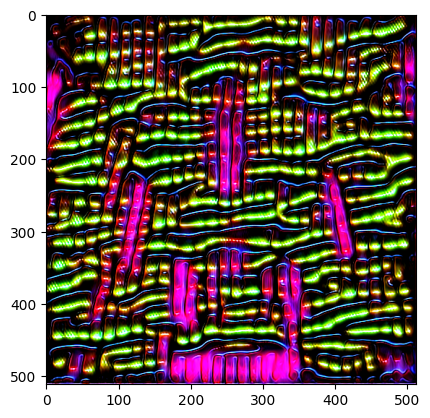

After 100 iters:
Total loss:  7106.9990234375
Content loss:  0.06201690062880516
patch loss:  0.7529296875
dir loss:  0.64111328125
TV loss:  1.1961679458618164
prompt : pop themed nightlife


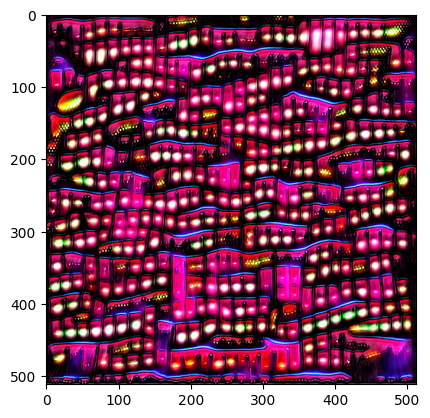

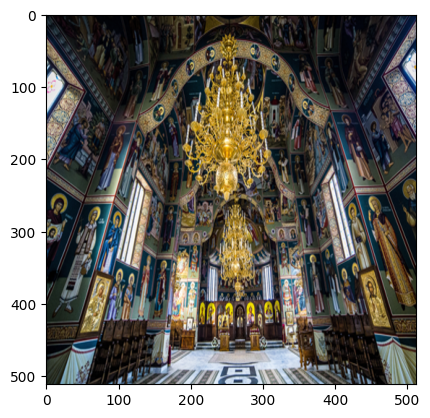

--------------------------

After 100 iters:
Total loss:  1404.48681640625
Content loss:  0.05525083839893341
patch loss:  0.1224365234375
dir loss:  0.58642578125
TV loss:  0.949187695980072
prompt : pencil Sketch


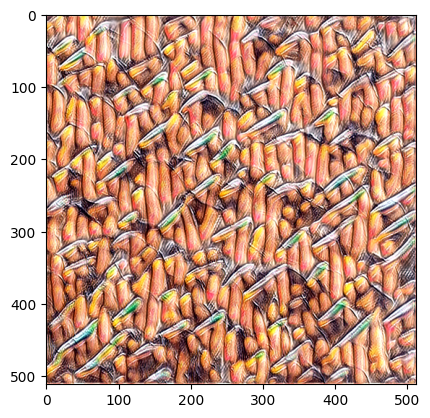

After 100 iters:
Total loss:  6936.00732421875
Content loss:  0.06063799187541008
patch loss:  0.73193359375
dir loss:  0.67529296875
TV loss:  1.1615996360778809
prompt : fire


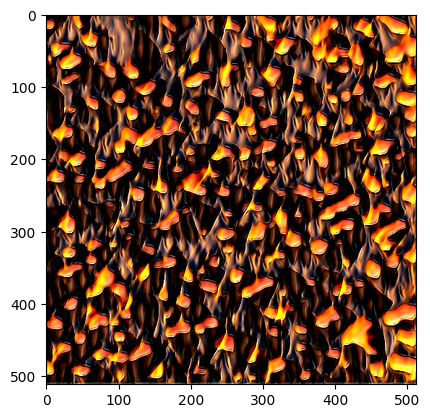

After 100 iters:
Total loss:  1505.6781005859375
Content loss:  0.0629459097981453
patch loss:  0.132568359375
dir loss:  0.603515625
TV loss:  1.4862066507339478
prompt : neon light


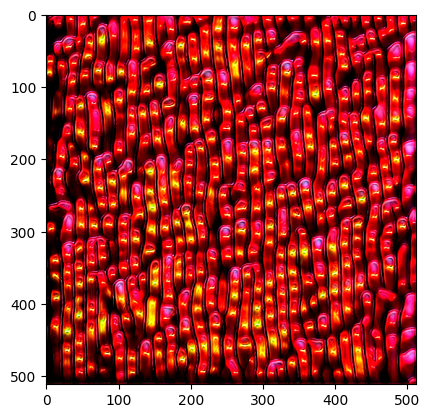

After 100 iters:
Total loss:  4669.52197265625
Content loss:  0.06375542283058167
patch loss:  0.480224609375
dir loss:  0.669921875
TV loss:  0.9587161540985107
prompt : pop themed nightlife


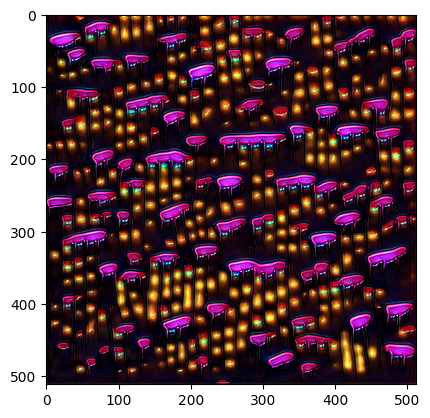

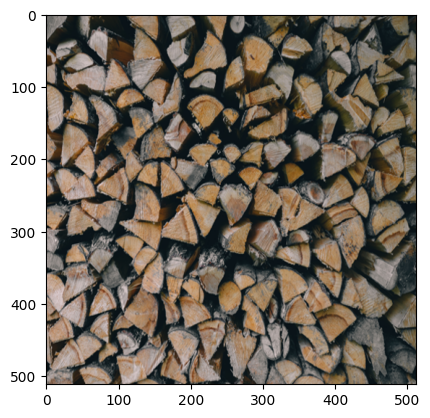

--------------------------

After 100 iters:
Total loss:  7293.4912109375
Content loss:  0.055630654096603394
patch loss:  0.76708984375
dir loss:  0.7607421875
TV loss:  0.8966980576515198
prompt : pencil Sketch


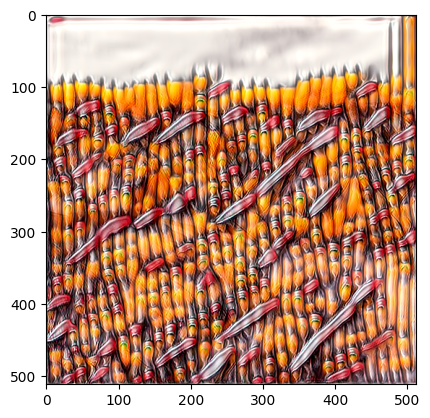

After 100 iters:
Total loss:  1892.9940185546875
Content loss:  0.05908414348959923
patch loss:  0.17626953125
dir loss:  0.59375
TV loss:  1.1313079595565796
prompt : fire


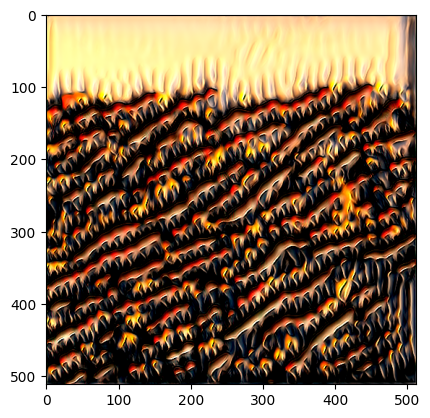

After 100 iters:
Total loss:  1022.8348999023438
Content loss:  0.06090044230222702
patch loss:  0.0777587890625
dir loss:  0.625
TV loss:  1.1998165845870972
prompt : neon light


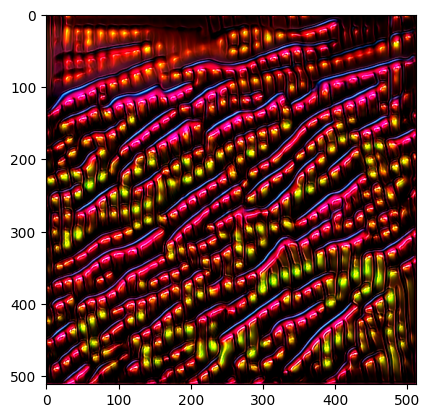

After 100 iters:
Total loss:  1315.091796875
Content loss:  0.05972852557897568
patch loss:  0.111572265625
dir loss:  0.6025390625
TV loss:  0.882443368434906
prompt : pop themed nightlife


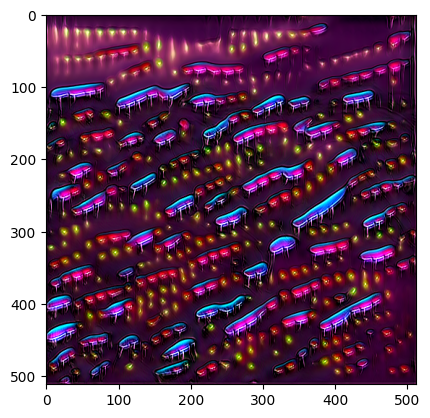

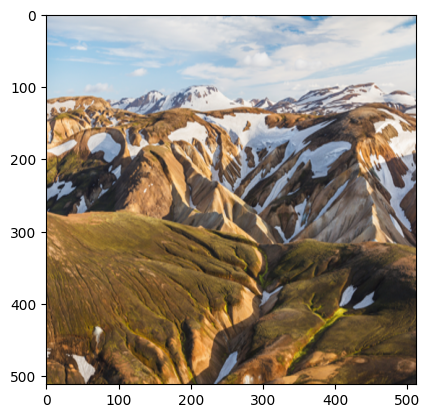

--------------------------

After 100 iters:
Total loss:  7131.056640625
Content loss:  0.05592085421085358
patch loss:  0.751953125
dir loss:  0.70751953125
TV loss:  0.9186651110649109
prompt : pencil Sketch


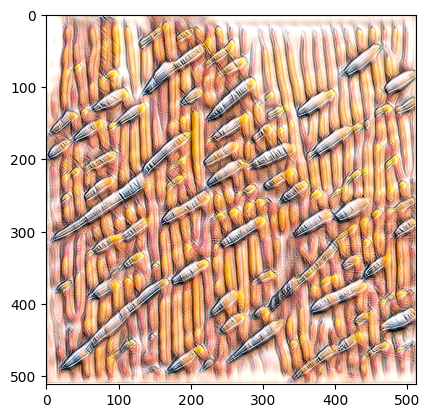

After 100 iters:
Total loss:  6712.986328125
Content loss:  0.06000472977757454
patch loss:  0.70751953125
dir loss:  0.66943359375
TV loss:  1.2359070777893066
prompt : fire


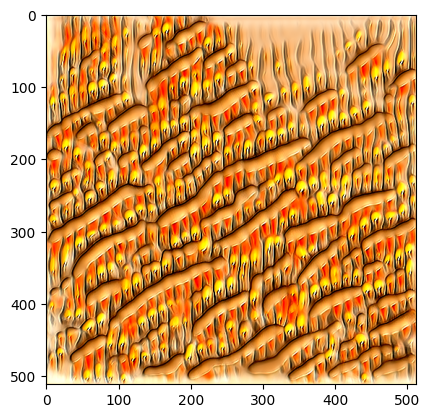

After 100 iters:
Total loss:  3346.21630859375
Content loss:  0.06104042008519173
patch loss:  0.33203125
dir loss:  0.69482421875
TV loss:  1.5602898597717285
prompt : neon light


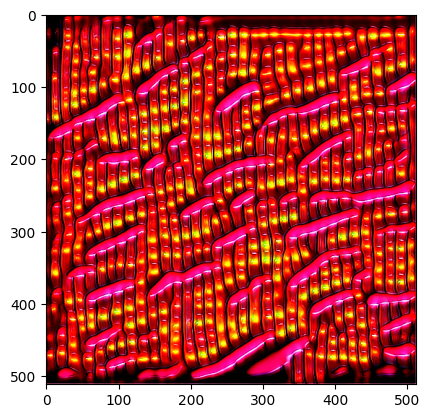

After 100 iters:
Total loss:  2613.499755859375
Content loss:  0.060066379606723785
patch loss:  0.25439453125
dir loss:  0.626953125
TV loss:  0.9897996187210083
prompt : pop themed nightlife


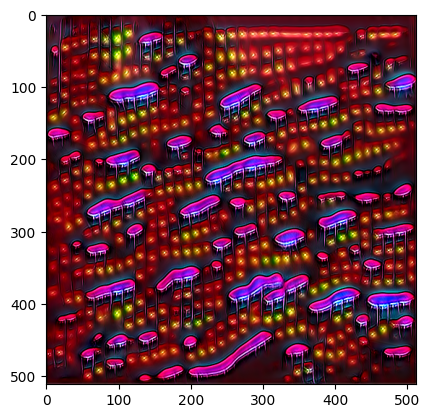

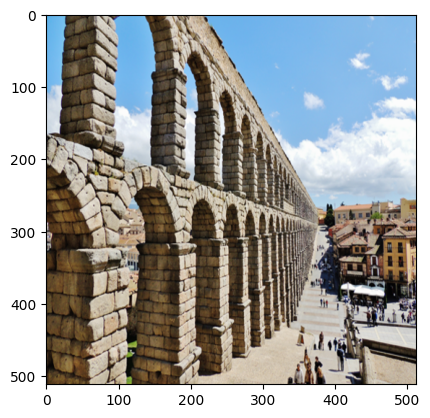

--------------------------

After 100 iters:
Total loss:  7137.41259765625
Content loss:  0.05987762659788132
patch loss:  0.75244140625
dir loss:  0.7109375
TV loss:  0.9311360120773315
prompt : pencil Sketch


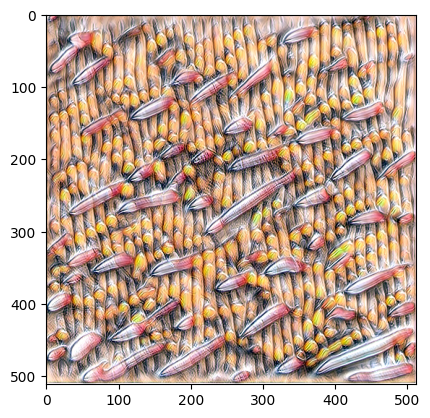

After 100 iters:
Total loss:  1375.261962890625
Content loss:  0.06186669319868088
patch loss:  0.12127685546875
dir loss:  0.54736328125
TV loss:  1.2319562435150146
prompt : fire


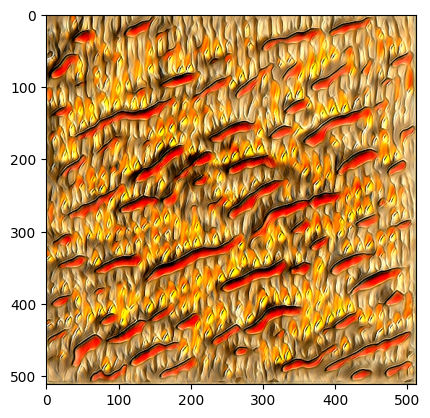

After 100 iters:
Total loss:  6875.7646484375
Content loss:  0.06329476833343506
patch loss:  0.724609375
dir loss:  0.689453125
TV loss:  1.5204131603240967
prompt : neon light


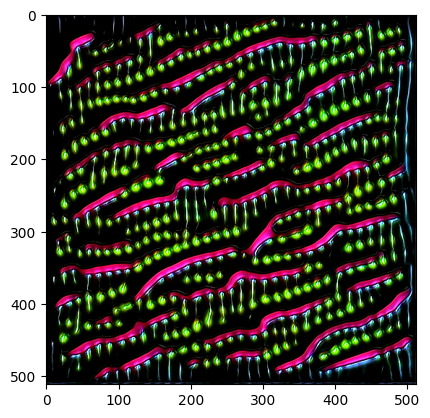

After 100 iters:
Total loss:  1511.232177734375
Content loss:  0.06363116204738617
patch loss:  0.1334228515625
dir loss:  0.599609375
TV loss:  0.9375284314155579
prompt : pop themed nightlife


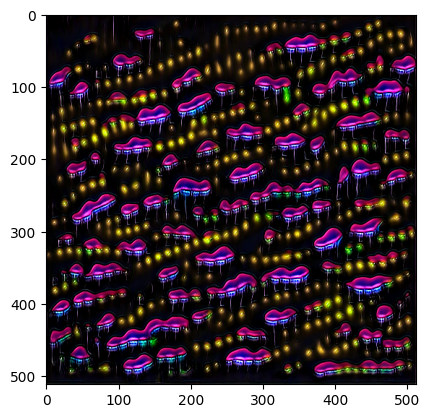

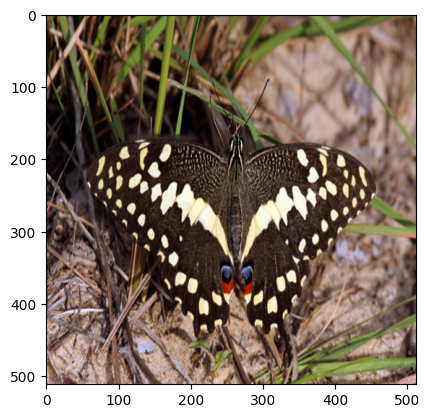

--------------------------

After 100 iters:
Total loss:  7713.50732421875
Content loss:  0.05961489677429199
patch loss:  0.810546875
dir loss:  0.81396484375
TV loss:  1.5651302337646484
prompt : pencil Sketch


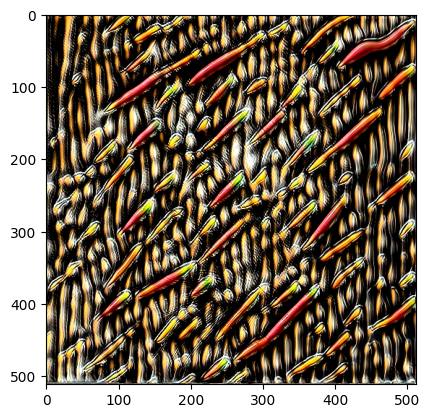

After 100 iters:
Total loss:  917.693603515625
Content loss:  0.06076289713382721
patch loss:  0.06585693359375
dir loss:  0.6298828125
TV loss:  1.0791610479354858
prompt : fire


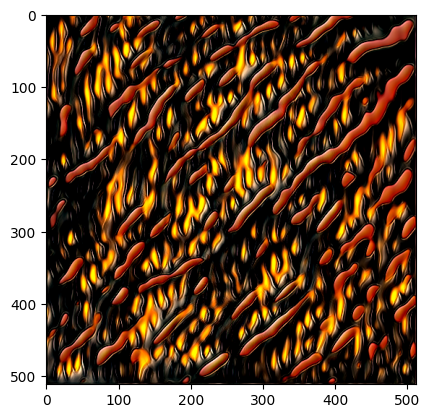

After 100 iters:
Total loss:  1213.485595703125
Content loss:  0.06105908751487732
patch loss:  0.099853515625
dir loss:  0.609375
TV loss:  1.0767863988876343
prompt : neon light


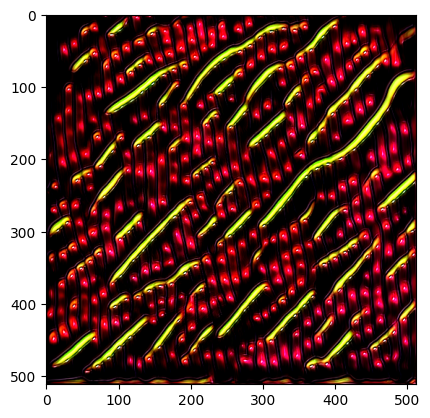

After 100 iters:
Total loss:  5360.755859375
Content loss:  0.060455285012722015
patch loss:  0.55908203125
dir loss:  0.63720703125
TV loss:  1.1877398490905762
prompt : pop themed nightlife


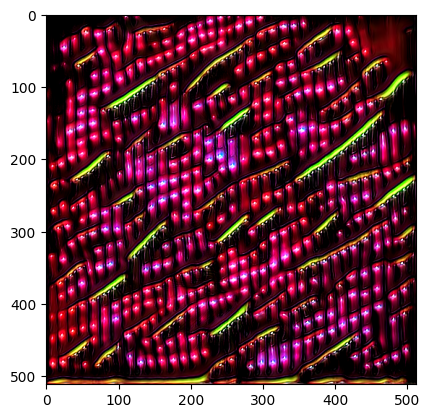

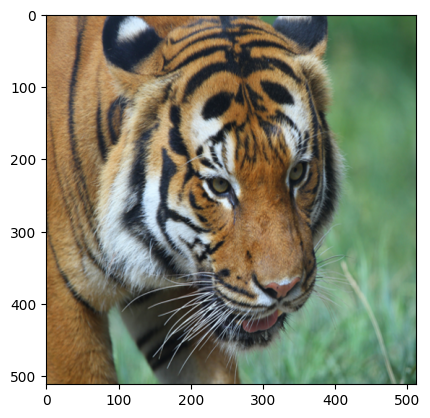

--------------------------

After 100 iters:
Total loss:  7503.4140625
Content loss:  0.05905039608478546
patch loss:  0.7900390625
dir loss:  0.76220703125
TV loss:  1.5567055940628052
prompt : pencil Sketch


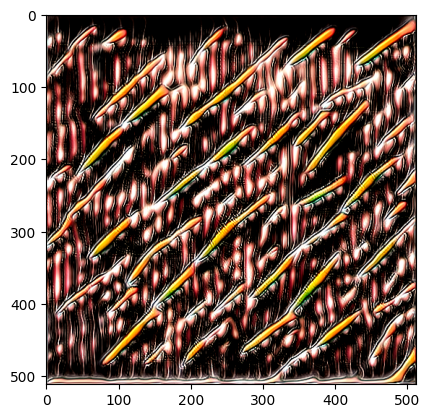

After 100 iters:
Total loss:  2310.7900390625
Content loss:  0.06030570715665817
patch loss:  0.2196044921875
dir loss:  0.64794921875
TV loss:  1.7441664934158325
prompt : fire


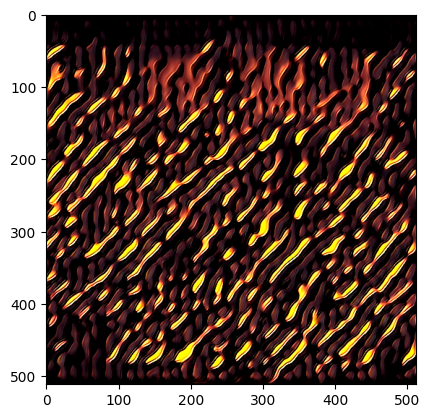

After 100 iters:
Total loss:  6862.1650390625
Content loss:  0.05860544368624687
patch loss:  0.7216796875
dir loss:  0.7119140625
TV loss:  1.3740602731704712
prompt : neon light


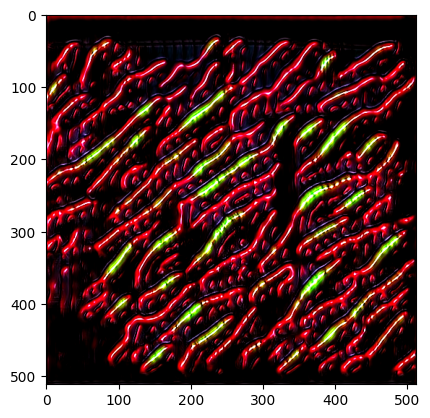

After 100 iters:
Total loss:  7821.728515625
Content loss:  0.05842294543981552
patch loss:  0.828125
dir loss:  0.7197265625
TV loss:  1.214806079864502
prompt : pop themed nightlife


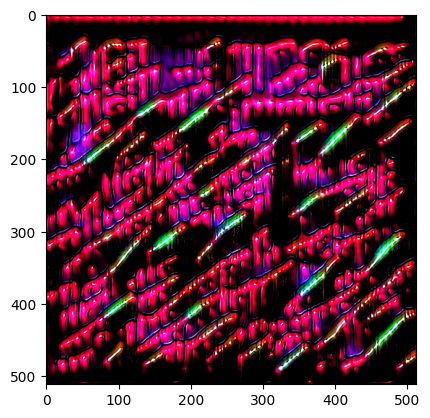

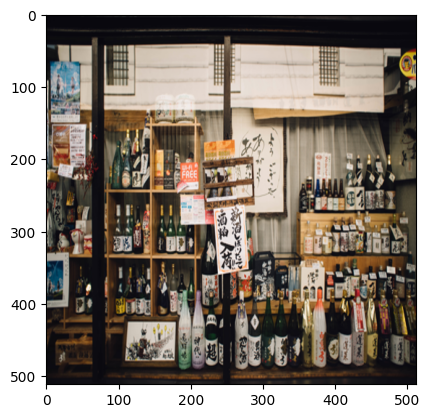

--------------------------

After 100 iters:
Total loss:  7386.68994140625
Content loss:  0.059341490268707275
patch loss:  0.77587890625
dir loss:  0.78466796875
TV loss:  1.5384676456451416
prompt : pencil Sketch


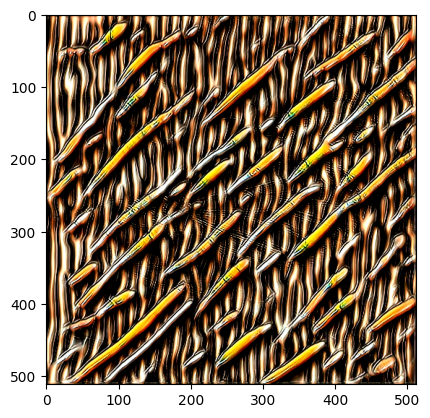

After 100 iters:
Total loss:  978.5084838867188
Content loss:  0.05967424809932709
patch loss:  0.0770263671875
dir loss:  0.5498046875
TV loss:  1.557379126548767
prompt : fire


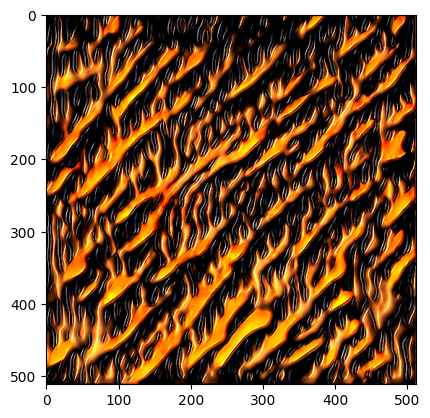

After 100 iters:
Total loss:  2227.834228515625
Content loss:  0.05971892178058624
patch loss:  0.2099609375
dir loss:  0.65478515625
TV loss:  1.3763154745101929
prompt : neon light


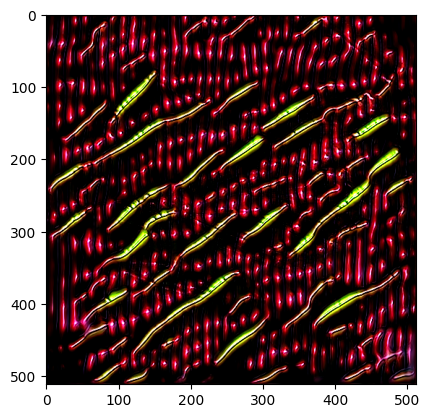

After 100 iters:
Total loss:  3815.0341796875
Content loss:  0.06077926978468895
patch loss:  0.389404296875
dir loss:  0.60107421875
TV loss:  1.4171161651611328
prompt : pop themed nightlife


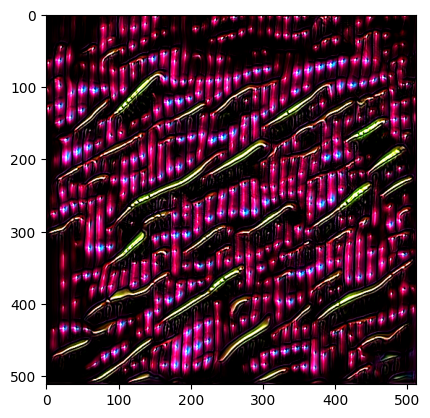

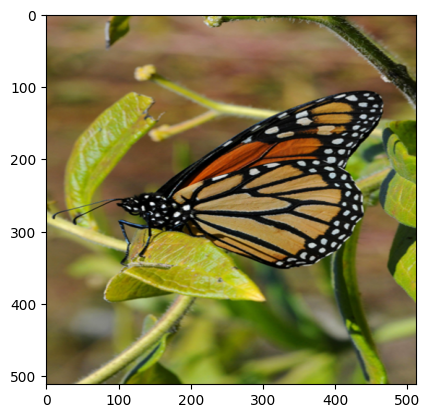

--------------------------

After 100 iters:
Total loss:  7422.2666015625
Content loss:  0.05650295317173004
patch loss:  0.78125
dir loss:  0.76025390625
TV loss:  1.540972352027893
prompt : pencil Sketch


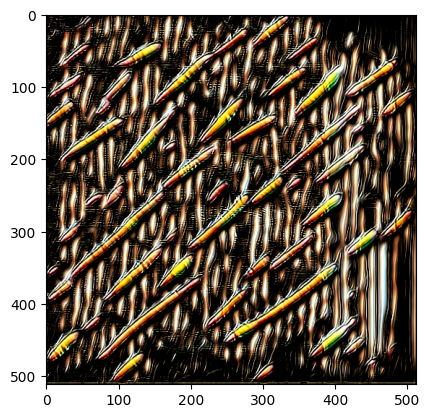

After 100 iters:
Total loss:  6699.87353515625
Content loss:  0.06088460981845856
patch loss:  0.705078125
dir loss:  0.6904296875
TV loss:  1.4908440113067627
prompt : fire


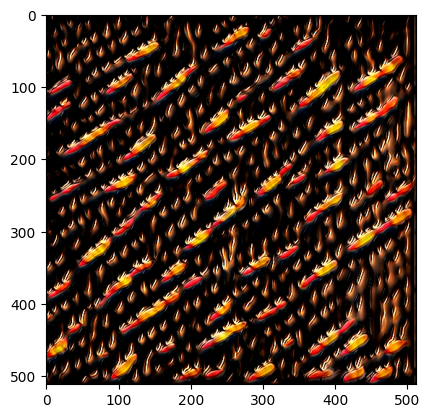

After 100 iters:
Total loss:  7092.48486328125
Content loss:  0.06031857430934906
patch loss:  0.748046875
dir loss:  0.7001953125
TV loss:  1.4370204210281372
prompt : neon light


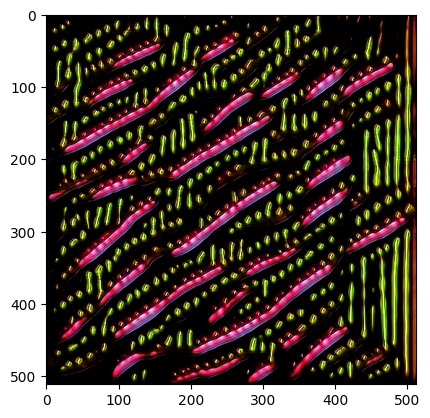

After 100 iters:
Total loss:  7527.93310546875
Content loss:  0.0589524582028389
patch loss:  0.79248046875
dir loss:  0.7724609375
TV loss:  0.8403274416923523
prompt : pop themed nightlife


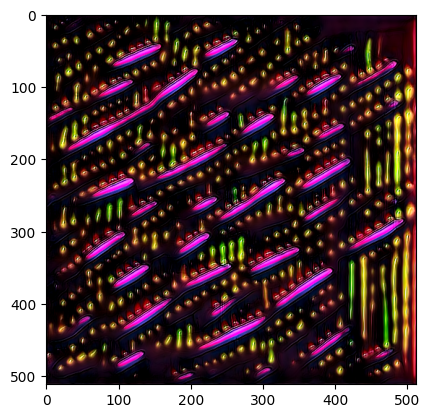

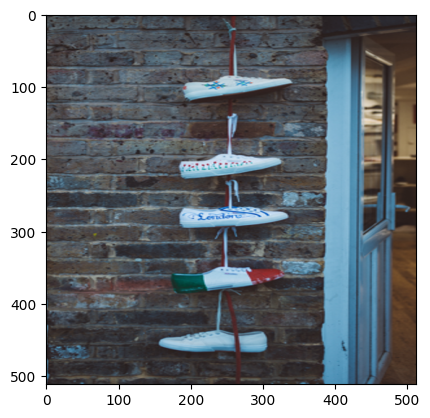

--------------------------

After 100 iters:
Total loss:  7210.86376953125
Content loss:  0.06086999177932739
patch loss:  0.7587890625
dir loss:  0.7451171875
TV loss:  1.2334579229354858
prompt : pencil Sketch


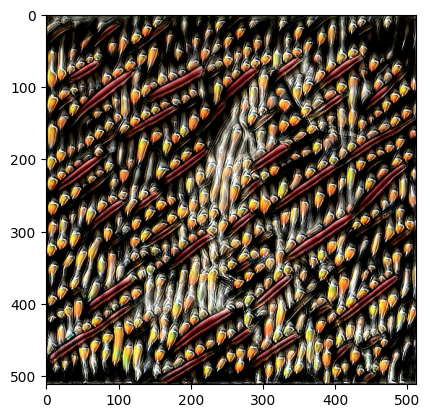

After 100 iters:
Total loss:  472.661376953125
Content loss:  0.06093025207519531
patch loss:  0.02191162109375
dir loss:  0.529296875
TV loss:  1.5218486785888672
prompt : fire


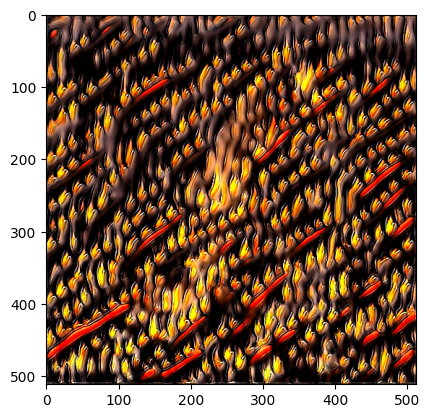

After 100 iters:
Total loss:  1626.969482421875
Content loss:  0.059739068150520325
patch loss:  0.1436767578125
dir loss:  0.6474609375
TV loss:  1.2587064504623413
prompt : neon light


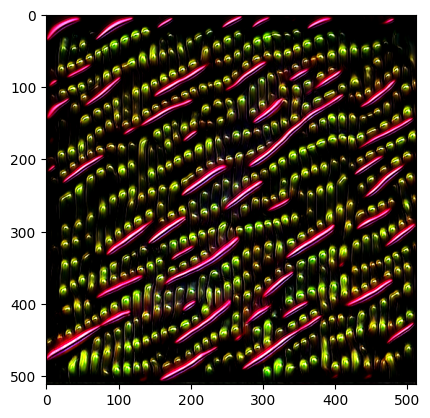

After 100 iters:
Total loss:  3526.2548828125
Content loss:  0.05905362591147423
patch loss:  0.355224609375
dir loss:  0.63720703125
TV loss:  0.8967646956443787
prompt : pop themed nightlife


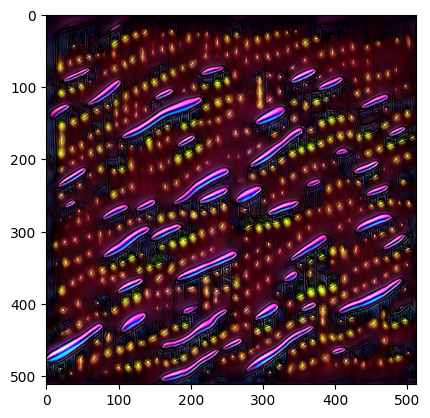

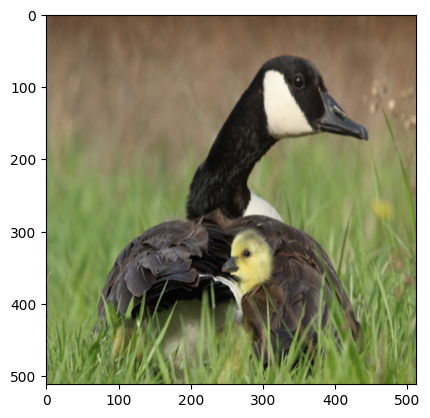

--------------------------

After 100 iters:
Total loss:  7112.609375
Content loss:  0.0580257885158062
patch loss:  0.7490234375
dir loss:  0.7255859375
TV loss:  1.1551450490951538
prompt : pencil Sketch


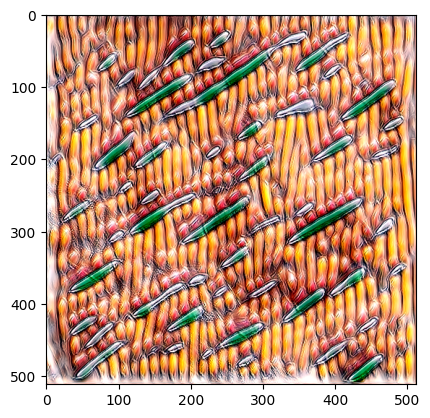

After 100 iters:
Total loss:  3312.623291015625
Content loss:  0.05924221873283386
patch loss:  0.33154296875
dir loss:  0.63671875
TV loss:  1.4870266914367676
prompt : fire


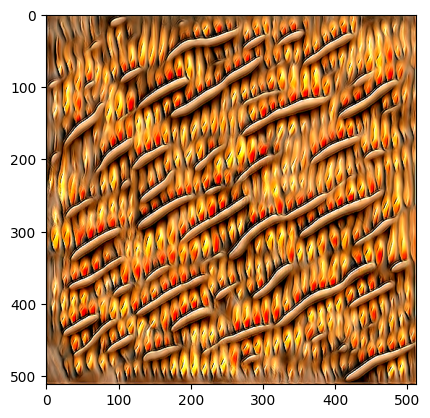

After 100 iters:
Total loss:  921.9237060546875
Content loss:  0.059961915016174316
patch loss:  0.066650390625
dir loss:  0.623046875
TV loss:  1.4294193983078003
prompt : neon light


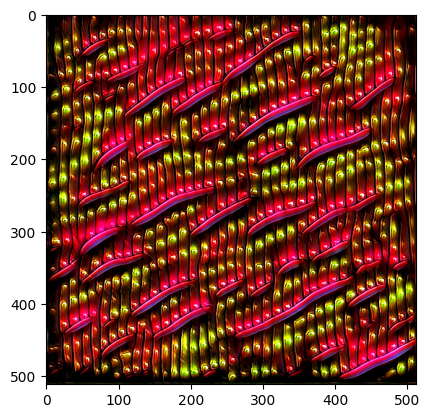

After 100 iters:
Total loss:  6988.5419921875
Content loss:  0.05956185981631279
patch loss:  0.73681640625
dir loss:  0.69287109375
TV loss:  1.1079658269882202
prompt : pop themed nightlife


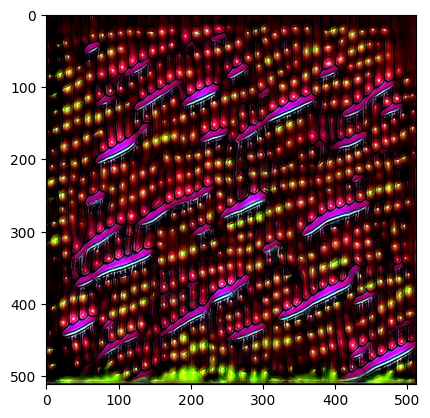

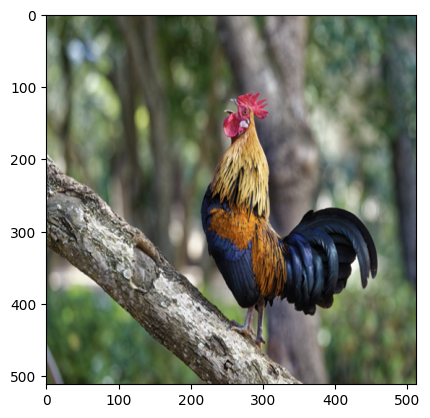

--------------------------

After 100 iters:
Total loss:  6959.48291015625
Content loss:  0.05878381431102753
patch loss:  0.73388671875
dir loss:  0.69140625
TV loss:  0.9154490232467651
prompt : pencil Sketch


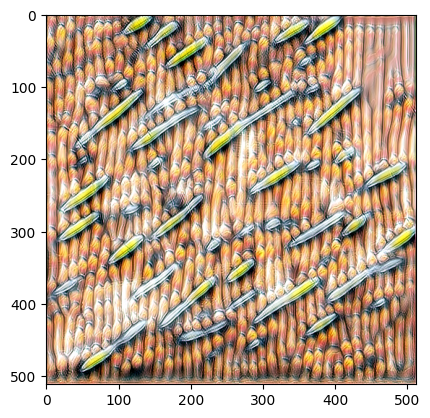

After 100 iters:
Total loss:  6825.08984375
Content loss:  0.05946845933794975
patch loss:  0.72119140625
dir loss:  0.6455078125
TV loss:  1.4195444583892822
prompt : fire


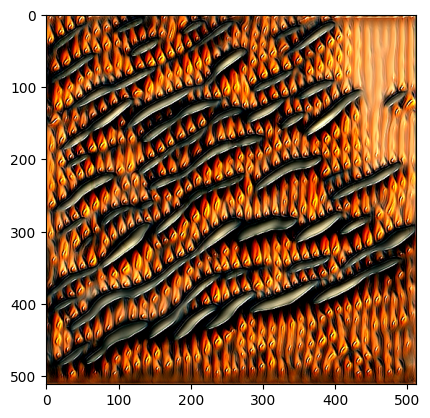

After 100 iters:
Total loss:  7047.1845703125
Content loss:  0.05951664596796036
patch loss:  0.7421875
dir loss:  0.7138671875
TV loss:  1.2570664882659912
prompt : neon light


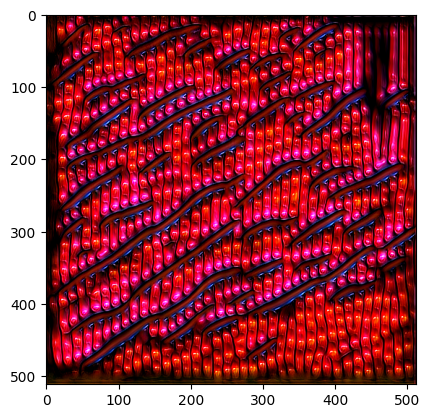

After 100 iters:
Total loss:  7043.76904296875
Content loss:  0.05989770591259003
patch loss:  0.7431640625
dir loss:  0.69140625
TV loss:  1.0341565608978271
prompt : pop themed nightlife


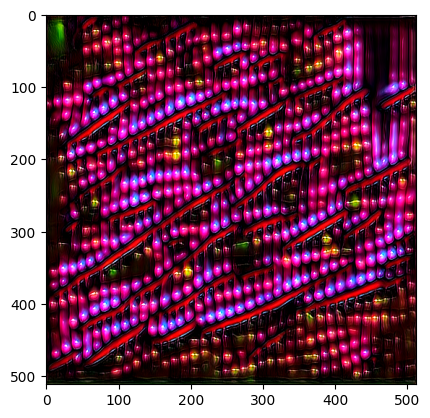

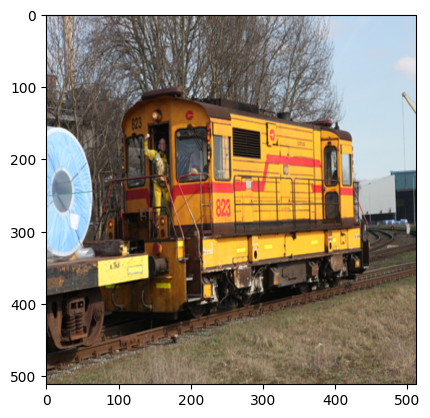

--------------------------

After 100 iters:
Total loss:  7621.6162109375
Content loss:  0.058406759053468704
patch loss:  0.80322265625
dir loss:  0.767578125
TV loss:  1.105088710784912
prompt : pencil Sketch


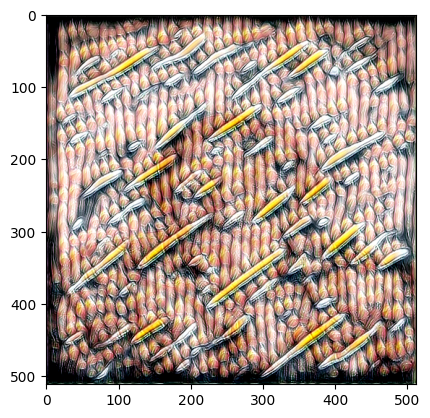

After 100 iters:
Total loss:  447.63250732421875
Content loss:  0.056938473135232925
patch loss:  0.021942138671875
dir loss:  0.48095703125
TV loss:  1.0917553901672363
prompt : fire


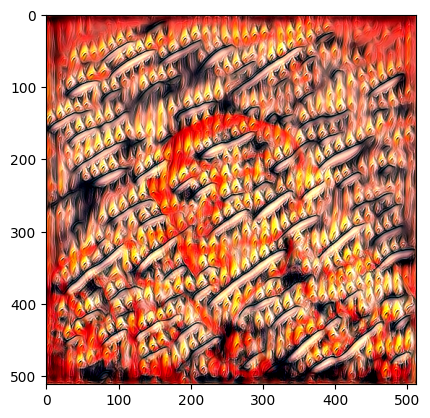

After 100 iters:
Total loss:  2196.864501953125
Content loss:  0.06140131130814552
patch loss:  0.210205078125
dir loss:  0.58837890625
TV loss:  1.4042752981185913
prompt : neon light


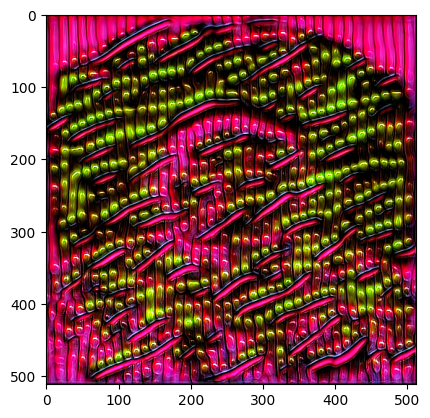

After 100 iters:
Total loss:  2500.015625
Content loss:  0.06032366305589676
patch loss:  0.2442626953125
dir loss:  0.583984375
TV loss:  0.9670737981796265
prompt : pop themed nightlife


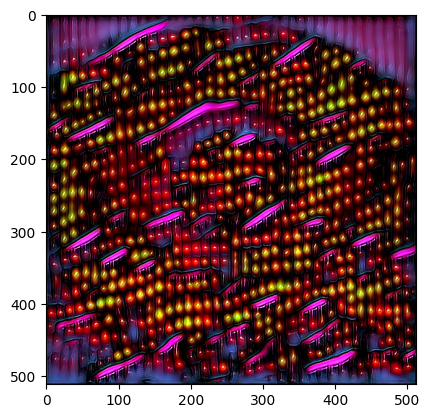

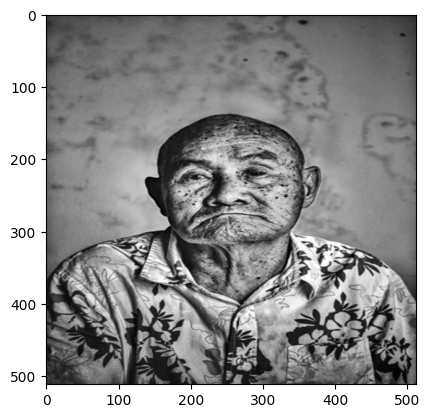

--------------------------

After 100 iters:
Total loss:  6936.451171875
Content loss:  0.059996992349624634
patch loss:  0.732421875
dir loss:  0.6689453125
TV loss:  0.9517130851745605
prompt : pencil Sketch


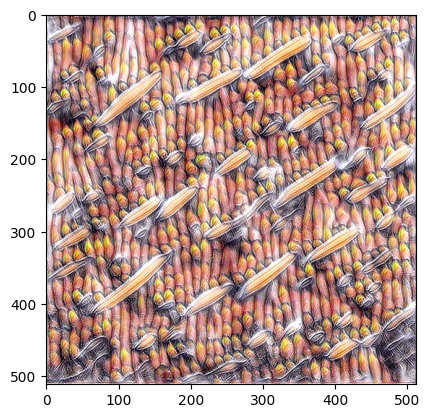

After 100 iters:
Total loss:  3722.31005859375
Content loss:  0.05925050377845764
patch loss:  0.376953125
dir loss:  0.6396484375
TV loss:  1.6724070310592651
prompt : fire


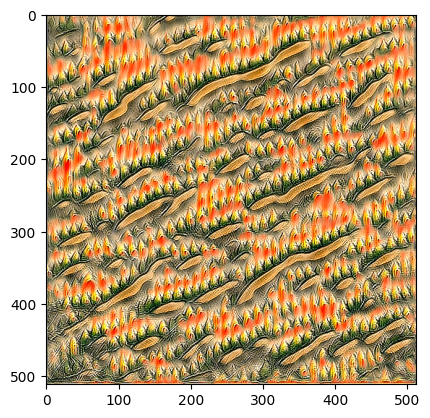

After 100 iters:
Total loss:  4955.71875
Content loss:  0.061699800193309784
patch loss:  0.5126953125
dir loss:  0.658203125
TV loss:  1.4636890888214111
prompt : neon light


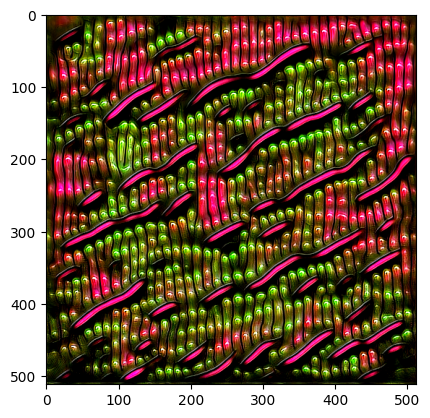

After 100 iters:
Total loss:  5431.83349609375
Content loss:  0.061033301055431366
patch loss:  0.56787109375
dir loss:  0.619140625
TV loss:  1.178655982017517
prompt : pop themed nightlife


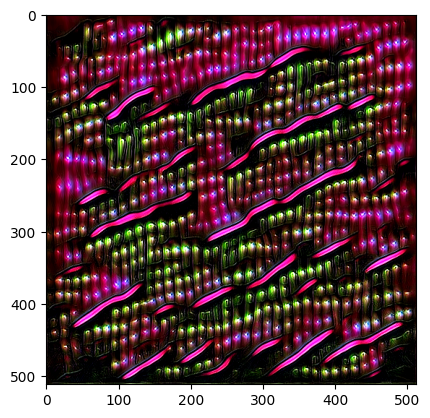

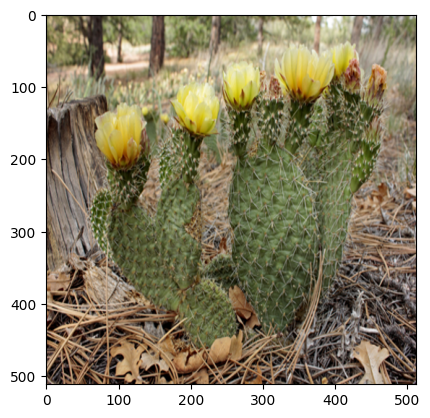

--------------------------

After 100 iters:
Total loss:  6887.14404296875
Content loss:  0.05604459345340729
patch loss:  0.72607421875
dir loss:  0.68359375
TV loss:  0.9873476028442383
prompt : pencil Sketch


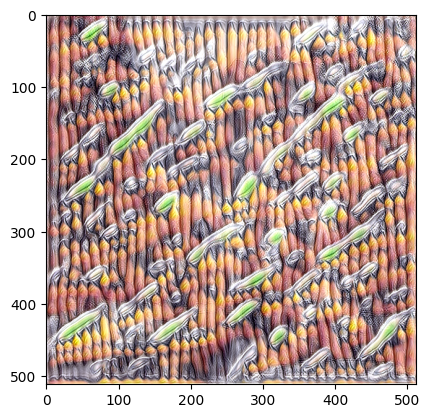

After 100 iters:
Total loss:  5413.072265625
Content loss:  0.056986965239048004
patch loss:  0.56640625
dir loss:  0.6142578125
TV loss:  1.2746082544326782
prompt : fire


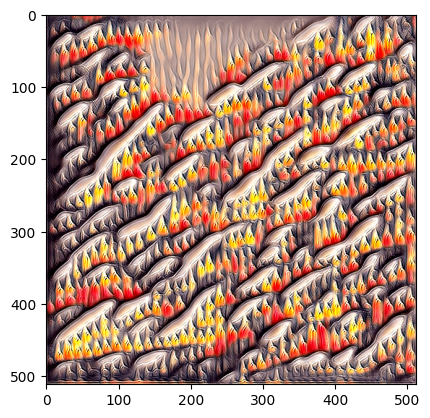

After 100 iters:
Total loss:  1803.3773193359375
Content loss:  0.05825047194957733
patch loss:  0.1661376953125
dir loss:  0.5966796875
TV loss:  1.3897881507873535
prompt : neon light


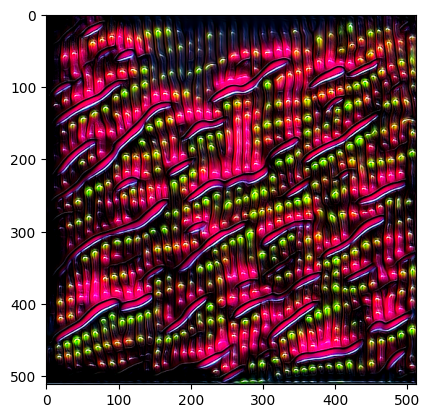

After 100 iters:
Total loss:  5651.94384765625
Content loss:  0.058177705854177475
patch loss:  0.591796875
dir loss:  0.6279296875
TV loss:  1.217225193977356
prompt : pop themed nightlife


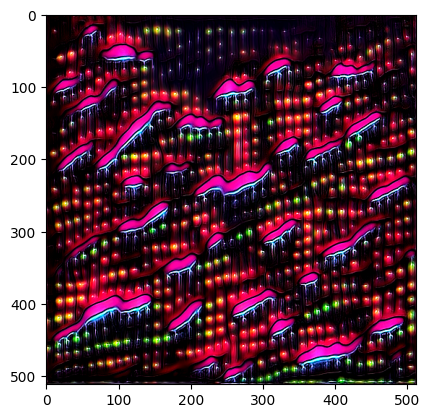

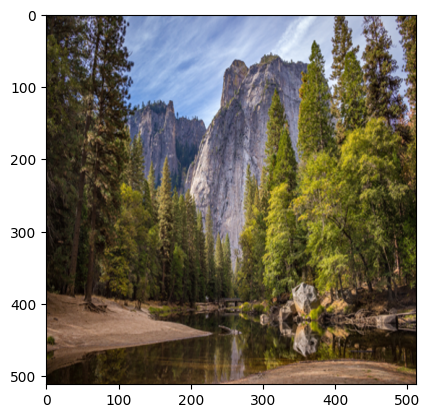

--------------------------

After 100 iters:
Total loss:  7095.4755859375
Content loss:  0.05750421807169914
patch loss:  0.748046875
dir loss:  0.70751953125
TV loss:  1.1001673936843872
prompt : pencil Sketch


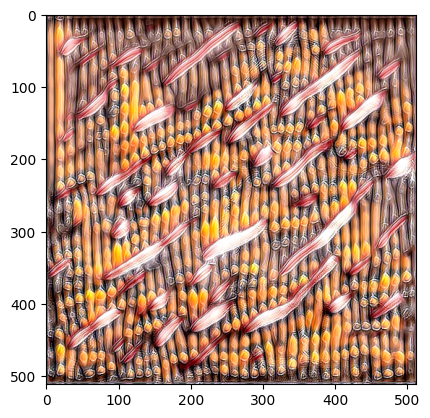

After 100 iters:
Total loss:  6574.56689453125
Content loss:  0.05632568150758743
patch loss:  0.69287109375
dir loss:  0.658203125
TV loss:  1.1183797121047974
prompt : fire


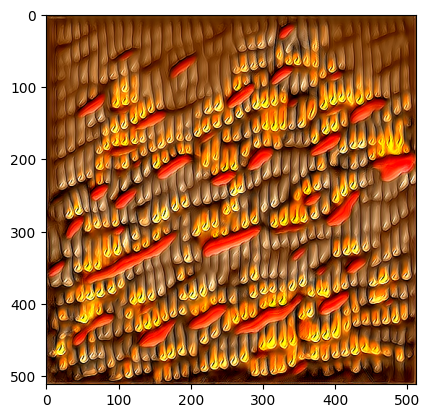

After 100 iters:
Total loss:  2507.837158203125
Content loss:  0.05763806402683258
patch loss:  0.245361328125
dir loss:  0.580078125
TV loss:  1.1914507150650024
prompt : neon light


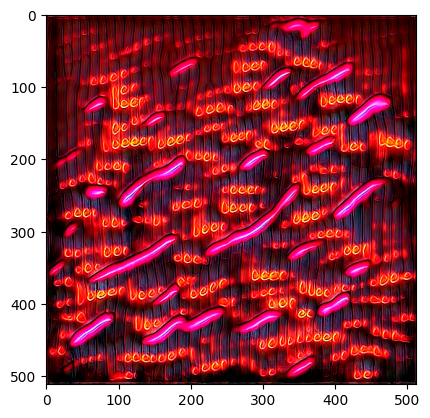

After 100 iters:
Total loss:  6981.9990234375
Content loss:  0.057582926005125046
patch loss:  0.73974609375
dir loss:  0.6318359375
TV loss:  1.3618354797363281
prompt : pop themed nightlife


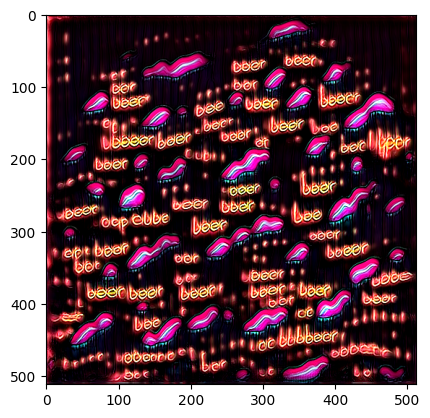

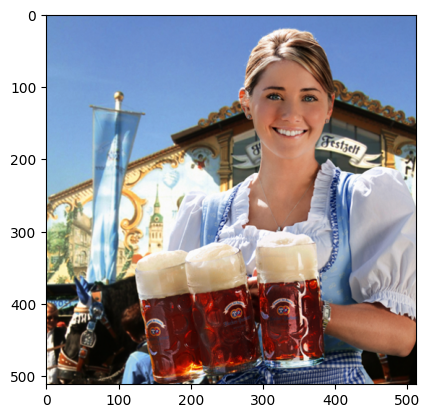

--------------------------

After 100 iters:
Total loss:  6925.1923828125
Content loss:  0.05653885379433632
patch loss:  0.72900390625
dir loss:  0.71044921875
TV loss:  1.4616453647613525
prompt : pencil Sketch


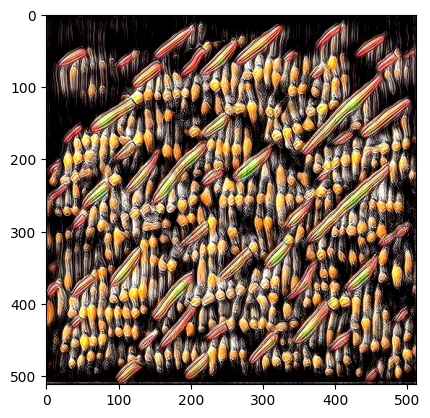

After 100 iters:
Total loss:  2039.67236328125
Content loss:  0.05668061226606369
patch loss:  0.1885986328125
dir loss:  0.666015625
TV loss:  1.1703284978866577
prompt : fire


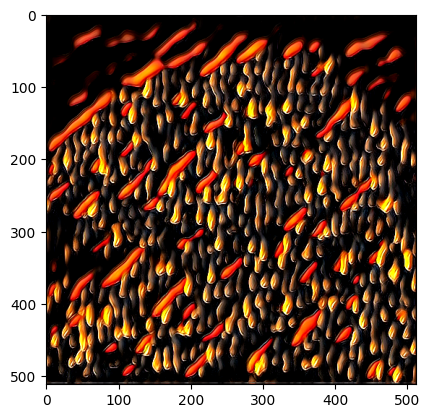

After 100 iters:
Total loss:  5974.96875
Content loss:  0.05732499808073044
patch loss:  0.6240234375
dir loss:  0.6982421875
TV loss:  1.3698809146881104
prompt : neon light


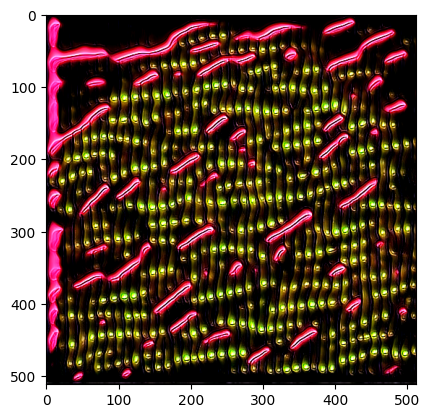

After 100 iters:
Total loss:  1206.96533203125
Content loss:  0.058391787111759186
patch loss:  0.09954833984375
dir loss:  0.6025390625
TV loss:  0.95658940076828
prompt : pop themed nightlife


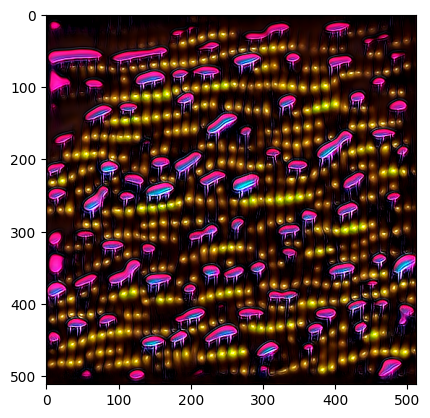

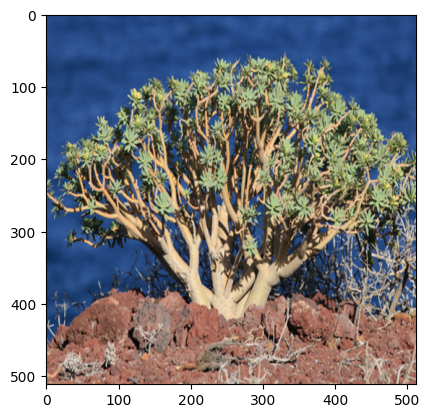

--------------------------

After 100 iters:
Total loss:  3616.573974609375
Content loss:  0.059772513806819916
patch loss:  0.3671875
dir loss:  0.60546875
TV loss:  0.8580621480941772
prompt : pencil Sketch


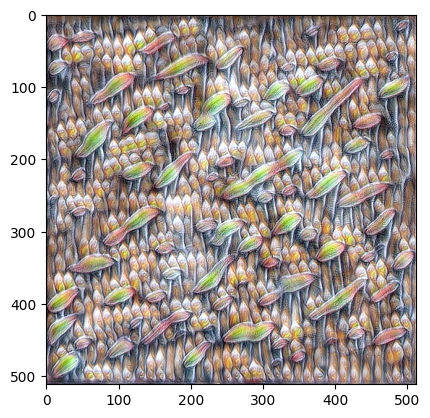

After 100 iters:
Total loss:  872.44677734375
Content loss:  0.059432871639728546
patch loss:  0.066162109375
dir loss:  0.5341796875
TV loss:  1.0318762063980103
prompt : fire


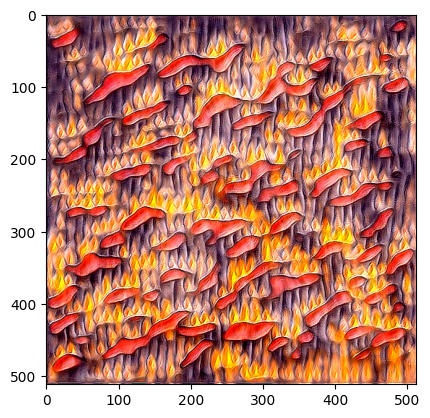

After 100 iters:
Total loss:  6342.064453125
Content loss:  0.06105099245905876
patch loss:  0.66455078125
dir loss:  0.703125
TV loss:  1.4069045782089233
prompt : neon light


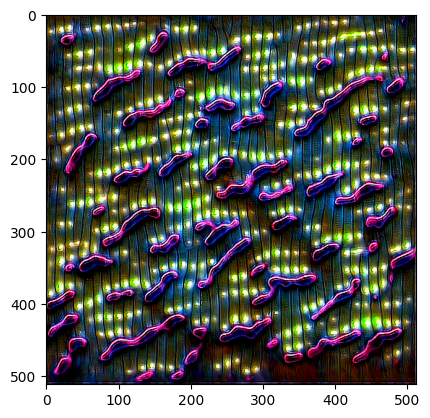

After 100 iters:
Total loss:  2110.024169921875
Content loss:  0.06211235746741295
patch loss:  0.199951171875
dir loss:  0.59912109375
TV loss:  1.2072519063949585
prompt : pop themed nightlife


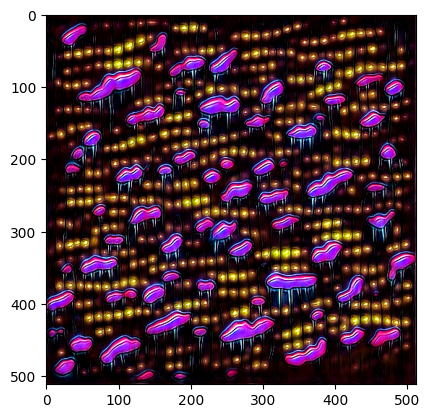

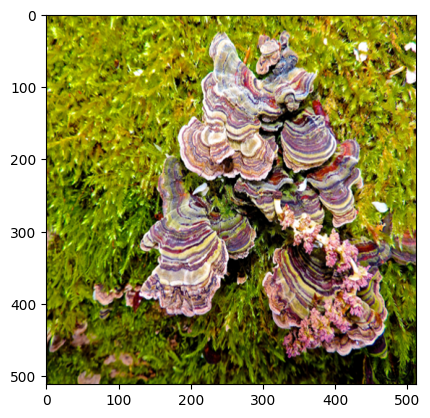

--------------------------

After 100 iters:
Total loss:  6950.109375
Content loss:  0.05840899795293808
patch loss:  0.732421875
dir loss:  0.6962890625
TV loss:  1.0983102321624756
prompt : pencil Sketch


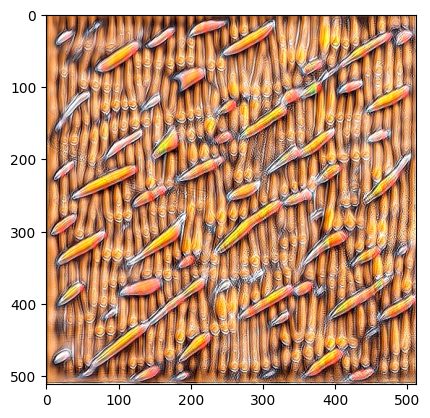

After 100 iters:
Total loss:  1226.552978515625
Content loss:  0.05975746363401413
patch loss:  0.0994873046875
dir loss:  0.6416015625
TV loss:  1.3394176959991455
prompt : fire


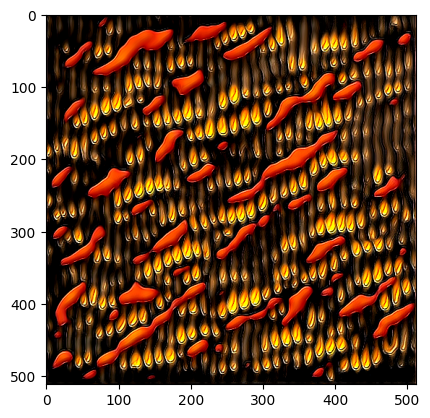

After 100 iters:
Total loss:  598.1646728515625
Content loss:  0.05873601883649826
patch loss:  0.032989501953125
dir loss:  0.58203125
TV loss:  1.3542810678482056
prompt : neon light


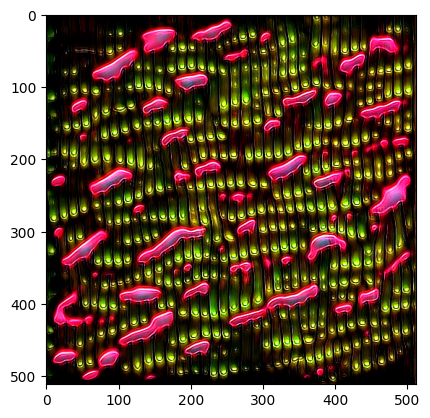

After 100 iters:
Total loss:  2624.68701171875
Content loss:  0.059928879141807556
patch loss:  0.25439453125
dir loss:  0.64892578125
TV loss:  1.1977214813232422
prompt : pop themed nightlife


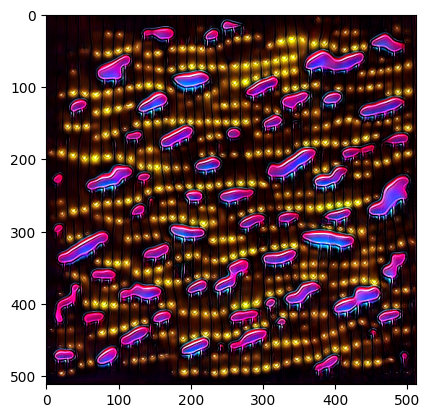

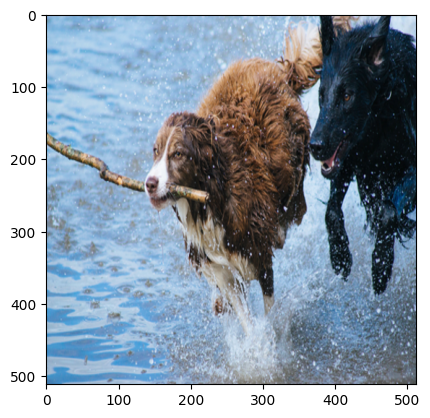

--------------------------

After 100 iters:
Total loss:  7304.38037109375
Content loss:  0.05901132524013519
patch loss:  0.76953125
dir loss:  0.7412109375
TV loss:  1.0289890766143799
prompt : pencil Sketch


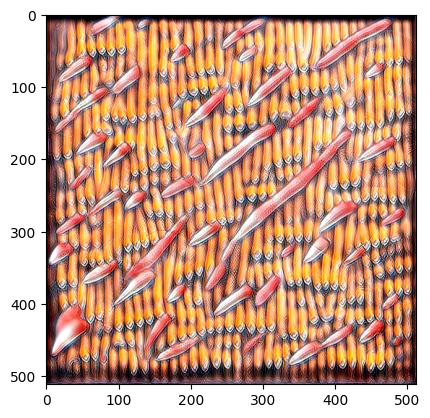

After 100 iters:
Total loss:  4119.74267578125
Content loss:  0.06165012717247009
patch loss:  0.419677734375
dir loss:  0.66015625
TV loss:  2.495211124420166
prompt : fire


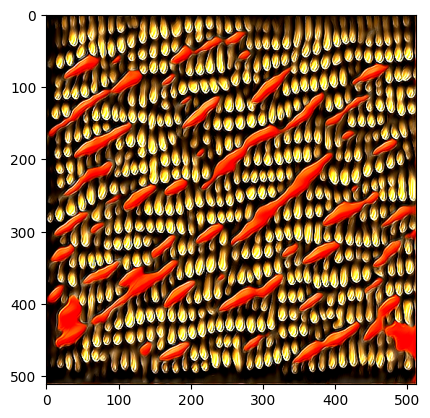

After 100 iters:
Total loss:  5812.255859375
Content loss:  0.060217343270778656
patch loss:  0.60498046875
dir loss:  0.7158203125
TV loss:  1.2232441902160645
prompt : neon light


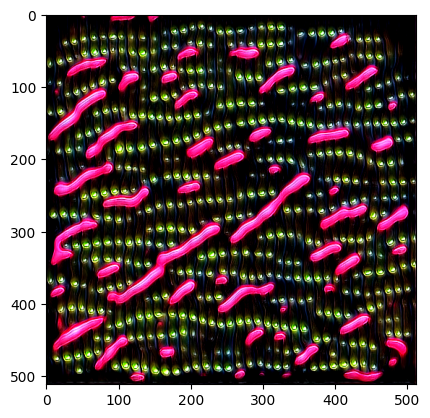

After 100 iters:
Total loss:  6488.87744140625
Content loss:  0.0607907734811306
patch loss:  0.68115234375
dir loss:  0.693359375
TV loss:  1.008843183517456
prompt : pop themed nightlife


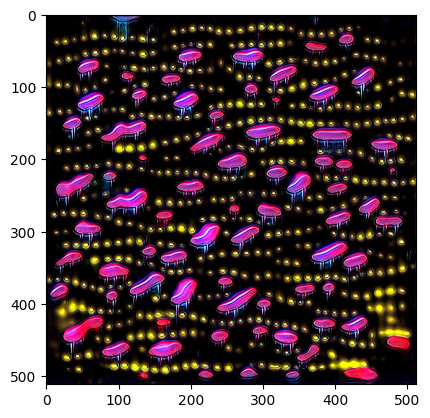

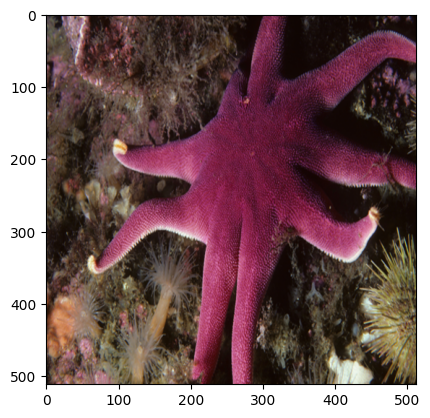

--------------------------

After 100 iters:
Total loss:  7449.5986328125
Content loss:  0.05630706250667572
patch loss:  0.7841796875
dir loss:  0.76806640625
TV loss:  1.1521695852279663
prompt : pencil Sketch


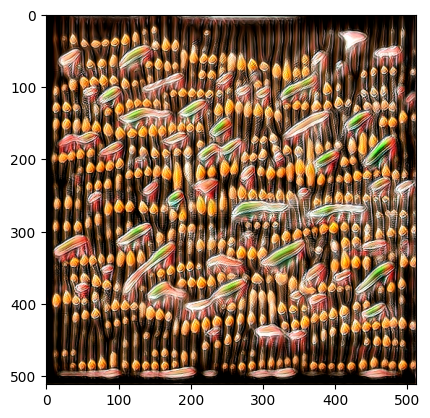

After 100 iters:
Total loss:  6884.44970703125
Content loss:  0.05689047649502754
patch loss:  0.72705078125
dir loss:  0.6611328125
TV loss:  1.4160200357437134
prompt : fire


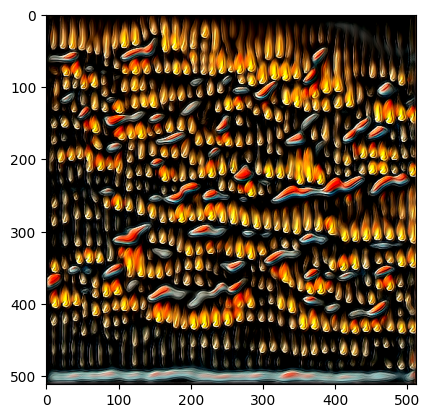

After 100 iters:
Total loss:  5142.4150390625
Content loss:  0.057858906686306
patch loss:  0.53369140625
dir loss:  0.6572265625
TV loss:  1.2362385988235474
prompt : neon light


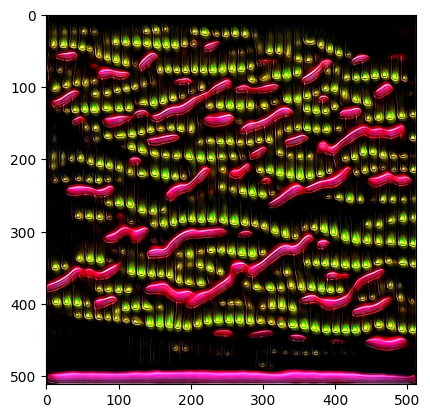

After 100 iters:
Total loss:  4659.1025390625
Content loss:  0.05895593762397766
patch loss:  0.479736328125
dir loss:  0.66650390625
TV loss:  1.0090813636779785
prompt : pop themed nightlife


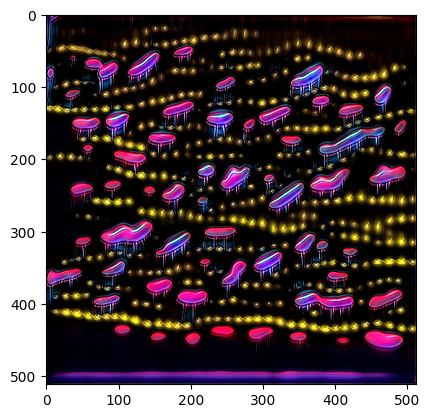

Buffered data was truncated after reaching the output size limit.

In [14]:
from IPython.display import display
from argparse import Namespace

source = "a Photo"

text = [ "pencil Sketch", "fire", "neon light", "pop themed nightlife"]
crop_size = 128

style_net = StyleNet_new.UNet()
style_net.to(device)

style_weights = {'conv1_1': 0.1,
                'conv2_1': 0.2,
                'conv3_1': 0.4,
                'conv4_1': 0.8,
                'conv5_1': 1.6}


clip_model, preprocess = clip.load('ViT-B/32', device, jit=False)
for i in jpg_files:
  for j in text:

    image_dir = "./train_data/" + i


    training_iterations = 100
    training_args = {
        "lambda_tv": 2e-3,
        "lambda_patch": 9000,
        "lambda_dir": 500,
        "lambda_c": 150,
        "crop_size": 128,
        "num_crops":64,
        "img_height":512,
        "img_width":512,
        "max_step":training_iterations,
        "lr":5e-4,
        "thresh":0.7,
        "content_path":image_dir,
        "text":text
    }

    args = Namespace(**training_args)

    def compose_text_with_templates(text: str, templates=imagenet_templates) -> list:
        return [template.format(text) for template in templates]

    content_path = args.content_path
    content_image = utils.load_image2(content_path, img_height=args.img_height,img_width =args.img_width)

    content_image = content_image.to(device)

    content_features = utils.get_features(img_normalize(content_image), resnet152)

    target = content_image.clone().requires_grad_(True).to(device)


    content_weight = args.lambda_c

    show_every = 100
    optimizer = optim.Adam(style_net.parameters(), lr=args.lr)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=100, gamma=0.5)
    steps = args.max_step

    content_loss_epoch = []
    style_loss_epoch = []
    total_loss_epoch = []

    output_image = content_image

    m_cont = torch.mean(content_image,dim=(2,3),keepdim=False).squeeze(0)
    m_cont = [m_cont[0].item(),m_cont[1].item(),m_cont[2].item()]

    cropper = transforms.Compose([
        transforms.RandomCrop(args.crop_size)
    ])
    augment = transforms.Compose([
        transforms.RandomPerspective(fill=0, p=1,distortion_scale=0.5),
        transforms.Resize(224)
    ])


    prompt = j

    source = "a Photo"


    with torch.no_grad():
        template_text = compose_text_with_templates(prompt, imagenet_templates)
        tokens = clip.tokenize(template_text).to(device)
        text_features = clip_model.encode_text(tokens).detach()
        text_features = text_features.mean(axis=0, keepdim=True)
        text_features /= text_features.norm(dim=-1, keepdim=True)

        template_source = compose_text_with_templates(source, imagenet_templates)
        tokens_source = clip.tokenize(template_source).to(device)
        text_source = clip_model.encode_text(tokens_source).detach()
        text_source = text_source.mean(axis=0, keepdim=True)
        text_source /= text_source.norm(dim=-1, keepdim=True)
        source_features = clip_model.encode_image(clip_normalize(content_image,device))
        source_features /= (source_features.clone().norm(dim=-1, keepdim=True))


    num_crops = args.num_crops
    for epoch in range(0, steps+1):

        scheduler.step()
        target = style_net(content_image,use_sigmoid=True).to(device)
        target.requires_grad_(True)

        target_features = utils.get_features(img_normalize(target), resnet152)

        content_loss = 0
        content_loss += torch.mean((target_features['conv2_1'] - content_features['conv2_1']) ** 2)

        loss_patch=0
        img_proc =[]
        for n in range(num_crops):
            target_crop = cropper(target)
            target_crop = augment(target_crop)
            img_proc.append(target_crop)

        img_proc = torch.cat(img_proc,dim=0)
        img_aug = img_proc

        image_features = clip_model.encode_image(clip_normalize(img_aug,device))
        image_features /= (image_features.clone().norm(dim=-1, keepdim=True))

        img_direction = (image_features-source_features)
        img_direction /= img_direction.clone().norm(dim=-1, keepdim=True)

        text_direction = (text_features-text_source).repeat(image_features.size(0),1)
        text_direction /= text_direction.norm(dim=-1, keepdim=True)
        loss_temp = (1- torch.cosine_similarity(img_direction, text_direction, dim=1))
        loss_temp[loss_temp<args.thresh] =0
        loss_patch+=loss_temp.mean()

        glob_features = clip_model.encode_image(clip_normalize(target,device))
        glob_features /= (glob_features.clone().norm(dim=-1, keepdim=True))

        glob_direction = (glob_features-source_features)
        glob_direction /= glob_direction.clone().norm(dim=-1, keepdim=True)

        loss_glob = (1- torch.cosine_similarity(glob_direction, text_direction, dim=1)).mean()

        reg_tv = args.lambda_tv*get_image_prior_losses(target)

        total_loss = args.lambda_patch*loss_patch + content_weight * content_loss+ reg_tv+ args.lambda_dir*loss_glob
        total_loss_epoch.append(total_loss)

        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        if epoch == 100:
            print("After %d iters:" % epoch)
            print('Total loss: ', total_loss.item())
            print('Content loss: ', content_loss.item())
            print('patch loss: ', loss_patch.item())
            print('dir loss: ', loss_glob.item())
            print('TV loss: ', reg_tv.item())

        if epoch == 100:
            print(f"prompt : {j}")
            output_image = target.clone()
            output_image = torch.clamp(output_image,0,1)
            output_image = adjust_contrast(output_image,1.5)
            plt.imshow(utils.im_convert2(output_image))
            plt.show()


  plt.imshow(utils.im_convert2(content_image))
  plt.show()
  print("--------------------------")
  print()


